**Mir Tahmid**

mirtahmid@gmail.com

# About Dataset

The dataset contains 35,814 entries and 21 columns, with various features related to climate and environmental data, such as temperature, solar radiation, soil moisture, and wind components. The data spans multiple years and includes information for different counties.

**Key Features:**

**county_name:** Name of the county.

**year:** Year of observation.

**month:** Month of observation.

**Multiple temperature metrics:** Dewpoint, soil temperature at different levels, temperature at 2m, max, and min temperatures.

**Radiation and solar metrics:** Surface net solar radiation, surface solar radiation downwards.

**Precipitation and evaporation metrics:** Total evaporation, total precipitation.

**Wind components:** u and v components of wind at 10m.

**Soil moisture:** Volumetric soil water at different layers.

# Load and Inspect the Dataset

load the dataset into a Pandas DataFrame.

In [ ]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
# Load the dataset
file_path = '/kaggle/input/eraland5-county-1961-2024-csv/eraland5_county_1961_2024.csv'
data = pd.read_csv(file_path)

# Display the first few rows and summary information
print(data.head())
print(data.info())

FileNotFoundError: [Errno 2] No such file or directory: '/kaggle/input/eraland5-county-1961-2024-csv/eraland5_county_1961_2024.csv'

# Missing Values Analysis

**Check for missing values in the dataset.**

In [ ]:
# Checking for missing values
missing_values = data.isnull().sum()
print(missing_values)

county_name                                      0
year                                             0
month                                            0
dewpoint_temperature_2m (°C)                     0
soil_temperature_level_1 (°C)                    0
soil_temperature_level_2 (°C)                    0
soil_temperature_level_3 (°C)                    0
soil_temperature_level_4 (°C)                    0
surface_net_solar_radiation_sum (J/m^2)          0
surface_solar_radiation_downwards_sum (J/m^2)    0
temperature_2m (°C)                              0
temperature_2m_max (°C)                          0
temperature_2m_min (°C)                          0
total_evaporation_sum (mm)                       0
total_precipitation_sum (mm)                     0
u_component_of_wind_10m (m/s)                    0
v_component_of_wind_10m (m/s)                    0
volumetric_soil_water_layer_1 (vol fraction)     0
volumetric_soil_water_layer_2 (vol fraction)     0
volumetric_soil_water_layer_3 (

# Checking Duplicates

In [ ]:
duplicates = data.duplicated()
print(duplicates.sum())

0


# Skewness and Kurtosis:

Examine the skewness and kurtosis of features to understand the shape of the distributions.

In [ ]:
skewness = data['temperature_2m_max (°C)'].skew()
kurtosis = data['temperature_2m_max (°C)'].kurt()
print(f'Skewness: {skewness}, Kurtosis: {kurtosis}')

Skewness: 0.1492154388990826, Kurtosis: -0.640042986738381


# Outlier Detection

# Multivariate outlier detection using the Mahalanobis distance

**Calculate the Mahalanobis distance for each observation.**

**Determine a threshold for identifying outliers based on the chi-square distribution.**

**Visualize the outliers using a scatter plot.**

**Mahalanobis Distance:** This measures the distance of a data point from the mean of a multivariate distribution, considering correlations between variables.

**Threshold:** Based on the chi-square distribution with a specified confidence level (e.g., 99%), this threshold helps identify outliers.

**Visualization:** The scatter plot shows the Mahalanobis distance for each observation, with a red line indicating the threshold. Points above the line are flagged as outliers.

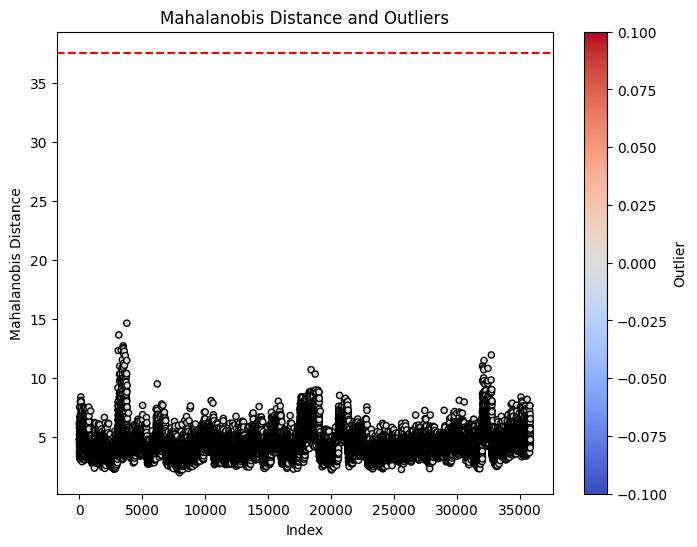

Number of outliers detected: 0
Mahalanobis distance threshold: 37.56623478662507


In [ ]:
import numpy as np
import pandas as pd
from scipy.stats import chi2
from numpy.linalg import inv
import matplotlib.pyplot as plt

# Function to calculate Mahalanobis distance
def mahalanobis_distance(X, data):
    covariance_matrix = np.cov(data.values, rowvar=False)
    inv_covariance_matrix = inv(covariance_matrix)
    mean_values = data.mean(axis=0)
    X_minus_mu = X - mean_values
    md = np.dot(np.dot(X_minus_mu, inv_covariance_matrix), X_minus_mu.T)
    return np.sqrt(md.diagonal())

# Load your data
data = pd.read_csv('/kaggle/input/eraland5-county-1961-2024-csv/eraland5_county_1961_2024.csv')  # Replace with your dataset path

# Select only numerical columns for multivariate outlier detection
columns_to_use = data.select_dtypes(include=[np.number]).columns.tolist()

# Calculate Mahalanobis distance for each observation
data_for_md = data[columns_to_use]
data_md = mahalanobis_distance(data_for_md, data_for_md)

# Determine the threshold for identifying outliers based on the chi-square distribution
threshold = chi2.ppf(0.99, df=data_for_md.shape[1])  # 99% confidence level
outliers = data_md > threshold

# Add the Mahalanobis distance and outlier flag to the DataFrame
data['Mahalanobis_Distance'] = data_md
data['Outlier_MD'] = outliers

# Visualize the outliers
plt.figure(figsize=(8, 6))
plt.scatter(range(len(data_md)), data_md, c=outliers, cmap='coolwarm', edgecolor='k', s=20)
plt.axhline(y=threshold, color='r', linestyle='--')
plt.title('Mahalanobis Distance and Outliers')
plt.xlabel('Index')
plt.ylabel('Mahalanobis Distance')
plt.colorbar(label='Outlier')
plt.show()

# Count the number of outliers
print(f"Number of outliers detected: {outliers.sum()}")
print(f"Mahalanobis distance threshold: {threshold}")


# Outliers Detection using Z-Score Method:

In [ ]:
import pandas as pd
import numpy as np

# Load your data
#data = pd.read_csv('your_dataset.csv')  # Replace with your dataset path

# Select numerical columns
numerical_cols = data.select_dtypes(include=[np.number])

# Calculate Z-scores
z_scores = np.abs((numerical_cols - numerical_cols.mean()) / numerical_cols.std())

# Identify outliers (Z-score > 3 or < -3)
outliers_z_score = z_scores > 3

# Print the number of outliers per column
print(outliers_z_score.sum())

year                                               0
month                                              0
dewpoint_temperature_2m (°C)                      10
soil_temperature_level_1 (°C)                      0
soil_temperature_level_2 (°C)                      0
soil_temperature_level_3 (°C)                      0
soil_temperature_level_4 (°C)                      0
surface_net_solar_radiation_sum (J/m^2)           23
surface_solar_radiation_downwards_sum (J/m^2)     47
temperature_2m (°C)                                0
temperature_2m_max (°C)                            0
temperature_2m_min (°C)                            0
total_evaporation_sum (mm)                         0
total_precipitation_sum (mm)                     521
u_component_of_wind_10m (m/s)                    515
v_component_of_wind_10m (m/s)                    325
volumetric_soil_water_layer_1 (vol fraction)       0
volumetric_soil_water_layer_2 (vol fraction)       0
volumetric_soil_water_layer_3 (vol fraction)  

# IQR Method:

In [ ]:
# Calculate Q1 (25th percentile) and Q3 (75th percentile)
Q1 = numerical_cols.quantile(0.25)
Q3 = numerical_cols.quantile(0.75)
IQR = Q3 - Q1

# Identify outliers using the IQR method
outliers_iqr = (numerical_cols < (Q1 - 1.5 * IQR)) | (numerical_cols > (Q3 + 1.5 * IQR))

# Print the number of outliers per column
print(outliers_iqr.sum())

year                                                0
month                                               0
dewpoint_temperature_2m (°C)                       29
soil_temperature_level_1 (°C)                       0
soil_temperature_level_2 (°C)                       0
soil_temperature_level_3 (°C)                       0
soil_temperature_level_4 (°C)                       0
surface_net_solar_radiation_sum (J/m^2)            64
surface_solar_radiation_downwards_sum (J/m^2)     118
temperature_2m (°C)                                 0
temperature_2m_max (°C)                             0
temperature_2m_min (°C)                             0
total_evaporation_sum (mm)                          0
total_precipitation_sum (mm)                     1349
u_component_of_wind_10m (m/s)                    1246
v_component_of_wind_10m (m/s)                    3680
volumetric_soil_water_layer_1 (vol fraction)        0
volumetric_soil_water_layer_2 (vol fraction)        0
volumetric_soil_water_layer_

# Visual Methods

# Boxplot: A graphical method to easily spot outliers.

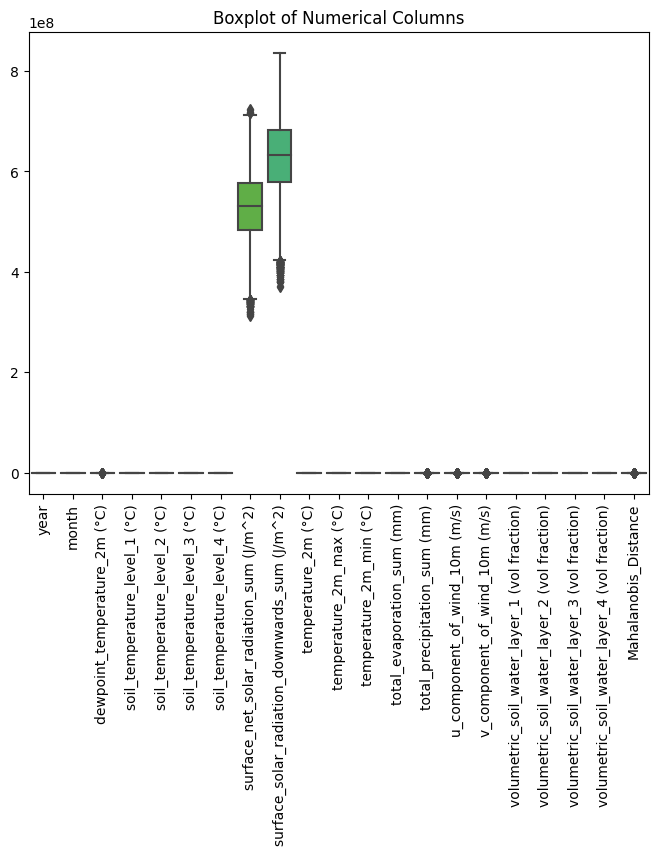

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a boxplot for each numerical column
plt.figure(figsize=(8, 6))
sns.boxplot(data=numerical_cols)
plt.xticks(rotation=90)
plt.title('Boxplot of Numerical Columns')
plt.show()

# Descriptive Statistics

**Generate descriptive statistics to understand the central tendency, dispersion, and shape of the data's distribution.**

In [ ]:
# Descriptive statistics for the dataset
descriptive_stats = data.describe()
print(descriptive_stats)

               year         month  dewpoint_temperature_2m (°C)  \
count  35814.000000  35814.000000                  35814.000000   
mean    1992.251969      6.476378                     14.487203   
std       18.332263      3.452020                      3.559448   
min     1961.000000      1.000000                      2.514335   
25%     1976.000000      3.000000                     11.905835   
50%     1992.000000      6.000000                     14.127132   
75%     2008.000000      9.000000                     16.856341   
max     2024.000000     12.000000                     24.520665   

       soil_temperature_level_1 (°C)  soil_temperature_level_2 (°C)  \
count                   35814.000000                   35814.000000   
mean                       23.139907                      23.112030   
std                         4.642838                       4.600697   
min                        13.423484                      13.497548   
25%                        19.240392     

In [ ]:
data.describe().T.round(2)

,count,mean,std,min,25%,50%,75%,max
year,35814.0,1.992250e+03,18.33,1.961000e+03,1.976000e+03,1.992000e+03,2.008000e+03,2.024000e+03
month,35814.0,6.480000e+00,3.45,1.000000e+00,3.000000e+00,6.000000e+00,9.000000e+00,1.200000e+01
dewpoint_temperature_2m (°C),35814.0,1.449000e+01,3.56,2.510000e+00,1.191000e+01,1.413000e+01,1.686000e+01,2.452000e+01
soil_temperature_level_1 (°C),35814.0,2.314000e+01,4.64,1.342000e+01,1.924000e+01,2.272000e+01,2.656000e+01,3.658000e+01
soil_temperature_level_2 (°C),35814.0,2.311000e+01,4.60,1.350000e+01,1.923000e+01,2.271000e+01,2.655000e+01,3.592000e+01
soil_temperature_level_3 (°C),35814.0,2.308000e+01,4.53,1.375000e+01,1.922000e+01,2.273000e+01,2.655000e+01,3.502000e+01
soil_temperature_level_4 (°C),35814.0,2.306000e+01,4.46,1.428000e+01,1.918000e+01,2.280000e+01,2.664000e+01,3.407000e+01
surface_net_solar_radiation_sum (J/m^2),35814.0,5.287037e+08,64880679.78,3.114312e+08,4.836607e+08,5.315728e+08,5.762222e+08,7.243813e+08
surface_solar_radiation_downwards_sum (J/m^2),35814.0,6.284148e+08,73921374.50,3.693281e+08,5.781437e+08,6.317482e+08,6.823063e+08,8.367634e+08
temperature_2m (°C),35814.0,2.114000e+01,4.03,1.167000e+01,1.790000e+01,2.085000e+01,2.429000e+01,3.231000e+01


# Visualizations

# Line plots of trends over time for selected features

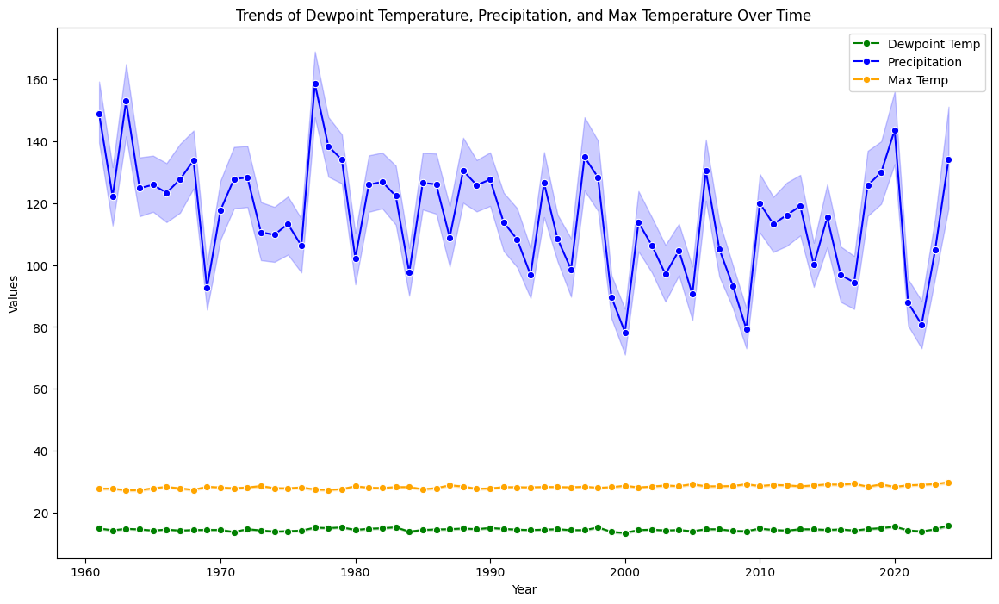

In [ ]:
# Line plots of trends over time for selected features
plt.figure(figsize=(14, 8))
sns.lineplot(x='year', y='dewpoint_temperature_2m (°C)', data=data, marker='o', color='green', label='Dewpoint Temp')
sns.lineplot(x='year', y='total_precipitation_sum (mm)', data=data, marker='o', color='blue', label='Precipitation')
sns.lineplot(x='year', y='temperature_2m_max (°C)', data=data, marker='o', color='orange', label='Max Temp')
plt.title('Trends of Dewpoint Temperature, Precipitation, and Max Temperature Over Time')
plt.xlabel('Year')
plt.ylabel('Values')
plt.legend()
plt.show()

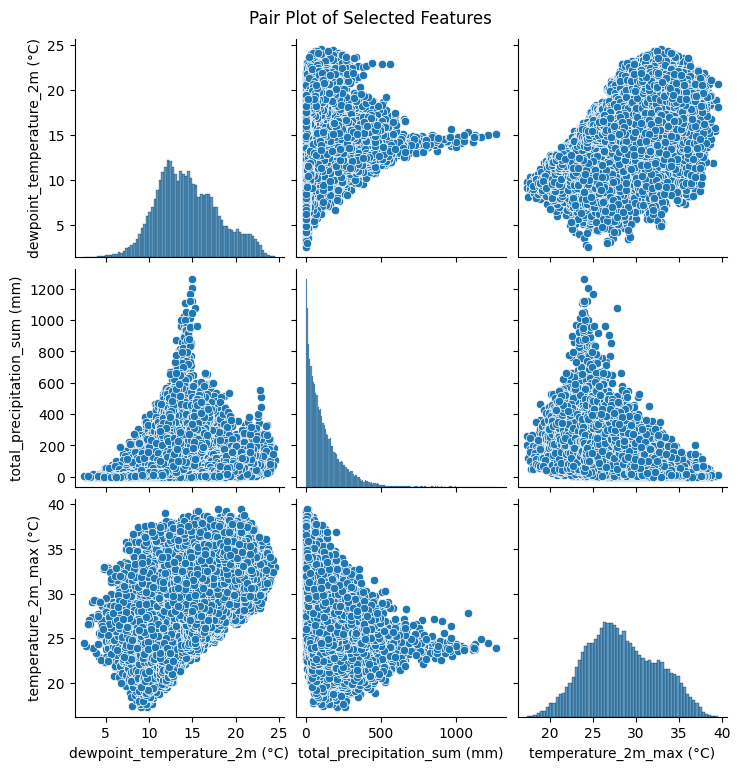

In [ ]:
#Pair plot to see relationships between variables
sns.pairplot(data[['dewpoint_temperature_2m (°C)', 'total_precipitation_sum (mm)', 'temperature_2m_max (°C)']])
plt.suptitle('Pair Plot of Selected Features', y=1.02)
plt.show()

# Histograms

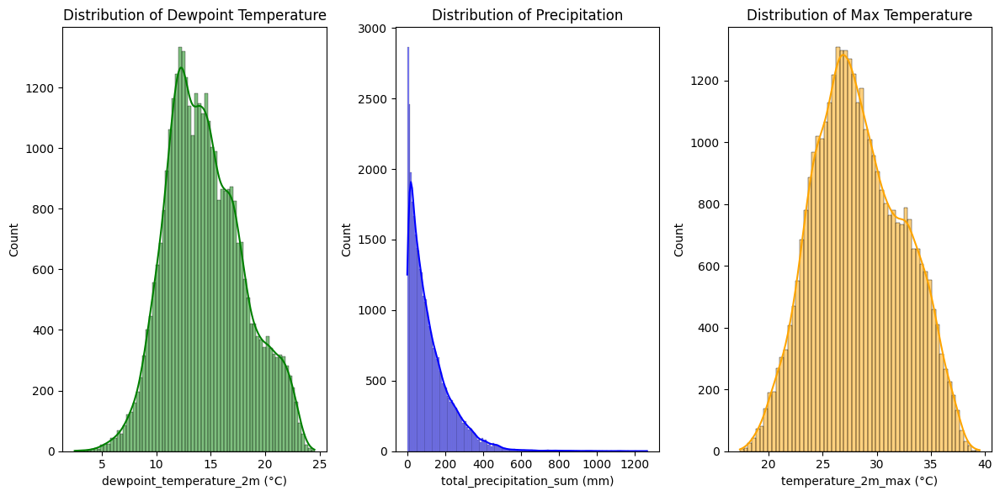

In [ ]:
# Distribution Plots (Histogram)
plt.figure(figsize=(12, 6))
plt.subplot(1, 3, 1)
sns.histplot(data['dewpoint_temperature_2m (°C)'], kde=True, color='green')
plt.title('Distribution of Dewpoint Temperature')

plt.subplot(1, 3, 2)
sns.histplot(data['total_precipitation_sum (mm)'], kde=True, color='blue')
plt.title('Distribution of Precipitation')

plt.subplot(1, 3, 3)
sns.histplot(data['temperature_2m_max (°C)'], kde=True, color='orange')
plt.title('Distribution of Max Temperature')

plt.tight_layout()
plt.show()

# Joint Plot

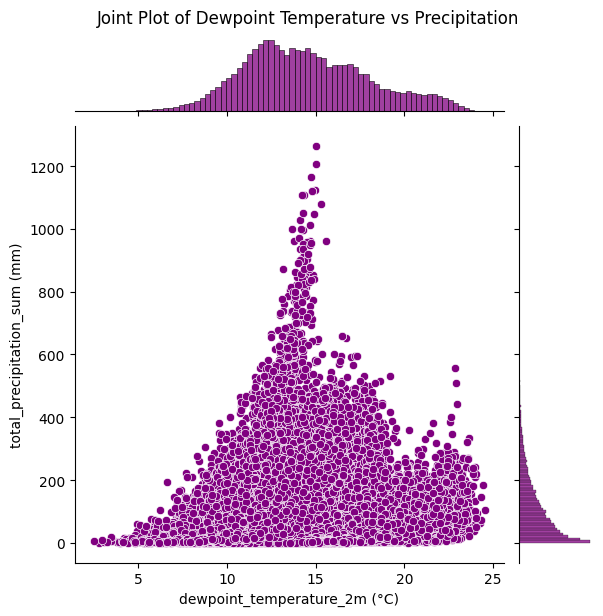

In [ ]:
#Jointplot to examine the relationship between two features
sns.jointplot(x='dewpoint_temperature_2m (°C)', y='total_precipitation_sum (mm)', data=data, kind='scatter', color='purple')
plt.suptitle('Joint Plot of Dewpoint Temperature vs Precipitation', y=1.02)
plt.show()

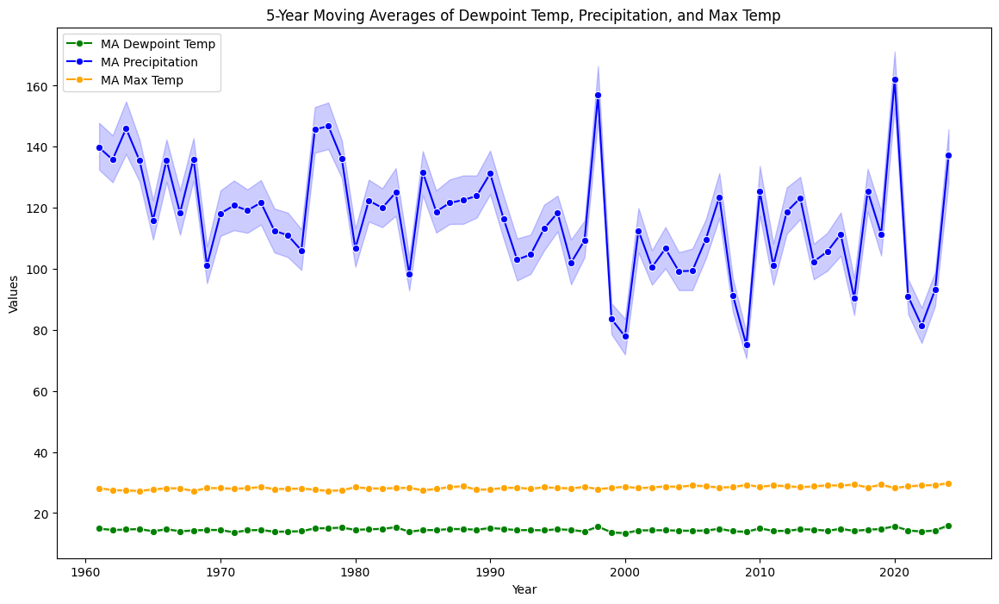

In [ ]:
# Moving Averages to smooth out the trend (for time series analysis)
data['MA_Dewpoint_Temp'] = data['dewpoint_temperature_2m (°C)'].rolling(window=5).mean()
data['MA_Precipitation'] = data['total_precipitation_sum (mm)'].rolling(window=5).mean()
data['MA_Max_Temp'] = data['temperature_2m_max (°C)'].rolling(window=5).mean()

plt.figure(figsize=(14, 8))
sns.lineplot(x='year', y='MA_Dewpoint_Temp', data=data, marker='o', color='green', label='MA Dewpoint Temp')
sns.lineplot(x='year', y='MA_Precipitation', data=data, marker='o', color='blue', label='MA Precipitation')
sns.lineplot(x='year', y='MA_Max_Temp', data=data, marker='o', color='orange', label='MA Max Temp')
plt.title('5-Year Moving Averages of Dewpoint Temp, Precipitation, and Max Temp')
plt.xlabel('Year')
plt.ylabel('Values')
plt.legend()
plt.show()

# Decompose Time Series:

Decompose the data into trend, seasonality, and residuals to better understand underlying patterns.

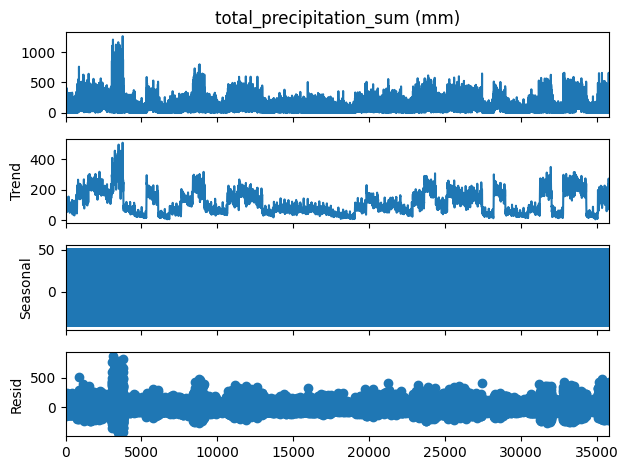

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
decomposition = seasonal_decompose(data['total_precipitation_sum (mm)'], model='additive', period=12)
decomposition.plot()
plt.show()

# Stationarity Tests:

Perform tests like the Augmented Dickey-Fuller (ADF) test to check for stationarity in time series data.

In [ ]:
from statsmodels.tsa.stattools import adfuller
adf_test = adfuller(data['total_precipitation_sum (mm)'])
print('ADF Statistic:', adf_test[0])
print('p-value:', adf_test[1])

ADF Statistic: -6.0959781446461365
p-value: 1.009871200156065e-07


# Distribution of Temperature

Create a histogram to visualize the distribution of the temperature at 2 meters.

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


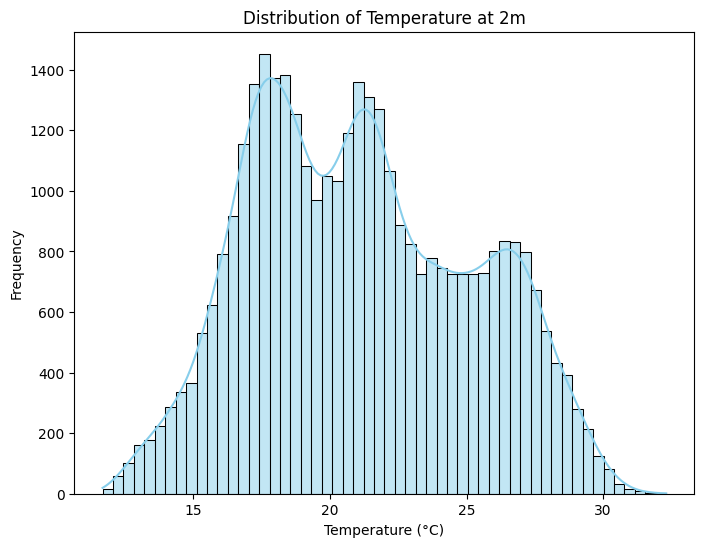

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Histogram of Temperature at 2m
plt.figure(figsize=(8, 6))
sns.histplot(data['temperature_2m (°C)'], kde=True, color='skyblue')
plt.title('Distribution of Temperature at 2m')
plt.xlabel('Temperature (°C)')
plt.ylabel('Frequency')
plt.show()

# Boxplot of Total Precipitation
Create a boxplot to visualize the spread and potential outliers in the total precipitation data.

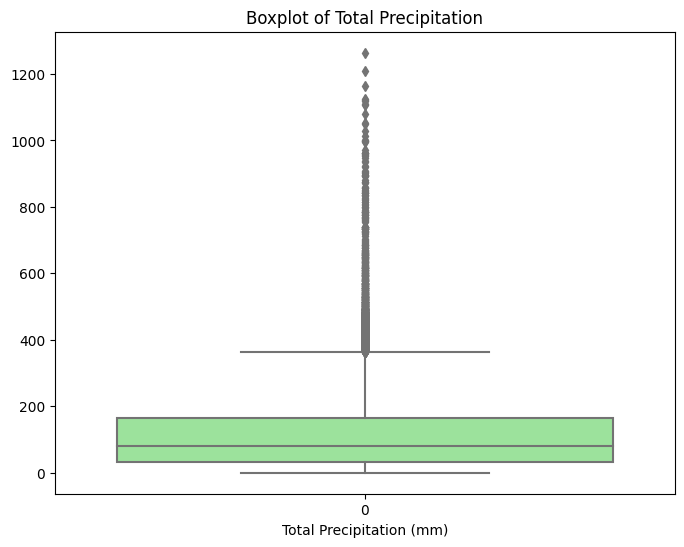

In [ ]:
# Boxplot of Total Precipitation
plt.figure(figsize=(8, 6))
sns.boxplot(data['total_precipitation_sum (mm)'], color='lightgreen')
plt.title('Boxplot of Total Precipitation')
plt.xlabel('Total Precipitation (mm)')
plt.show()

# Boxplots for all numerical features:

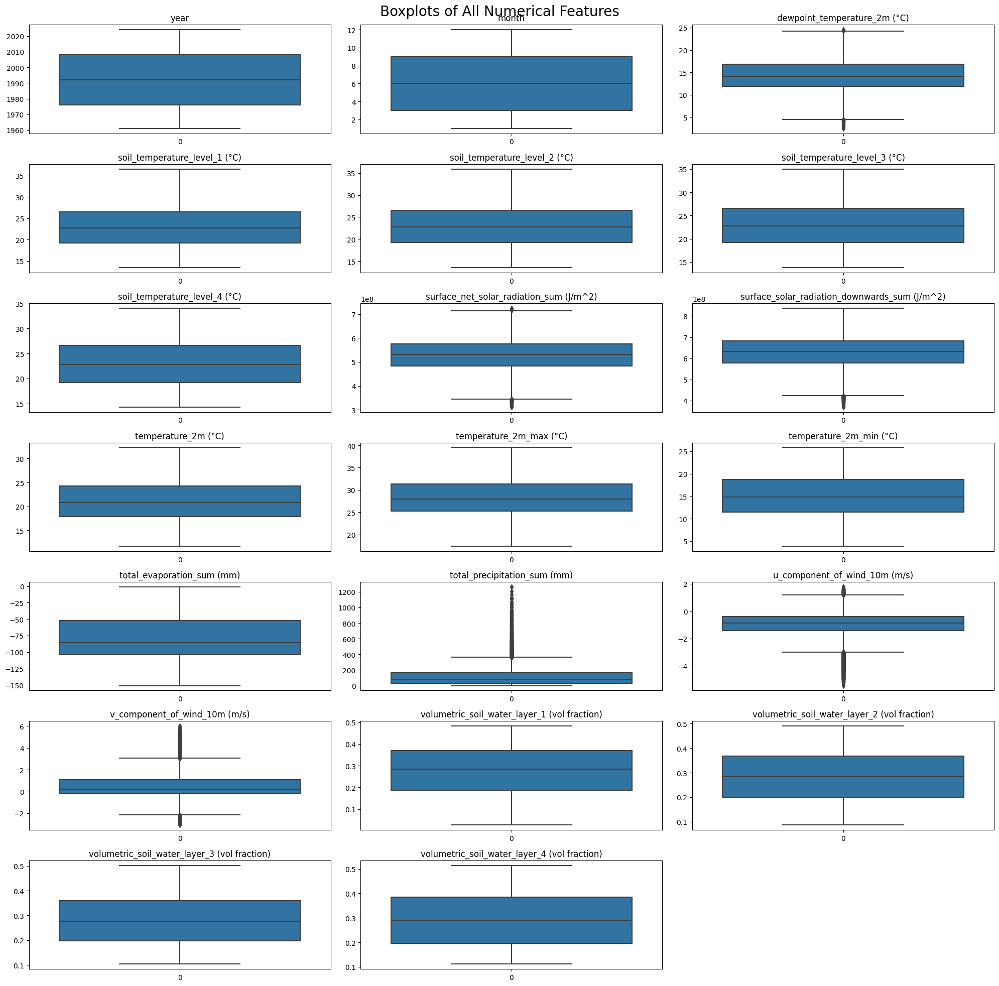

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set up the figure for boxplots
plt.figure(figsize=(20, 20))
plt.suptitle('Boxplots of All Numerical Features', fontsize=20)

# Select numerical columns only
numeric_columns = data.select_dtypes(include=['float64', 'int64']).columns

# Plot boxplots for each numerical feature
for i, column in enumerate(numeric_columns):
    plt.subplot(7, 3, i + 1)
    sns.boxplot(data[column])
    plt.title(column)
    plt.tight_layout()

plt.show()

# Scatter Plot based on Temp Vs. Precipitation

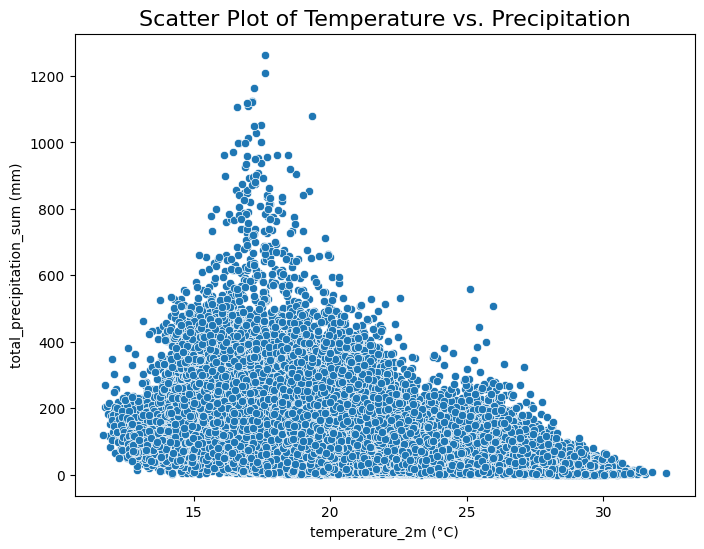

In [ ]:
# Example scatter plot for two features
plt.figure(figsize=(8, 6))
sns.scatterplot(x='temperature_2m (°C)', y='total_precipitation_sum (mm)', data=data)
plt.title('Scatter Plot of Temperature vs. Precipitation', fontsize=16)
plt.show()

# Time Series Plot for Temperature

Plot the yearly trend of temperature at 2 meters to observe changes over time.

/tmp/ipykernel_36/1356062039.py:3: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(x='year', y='temperature_2m (°C)', data=data, ci=None)
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


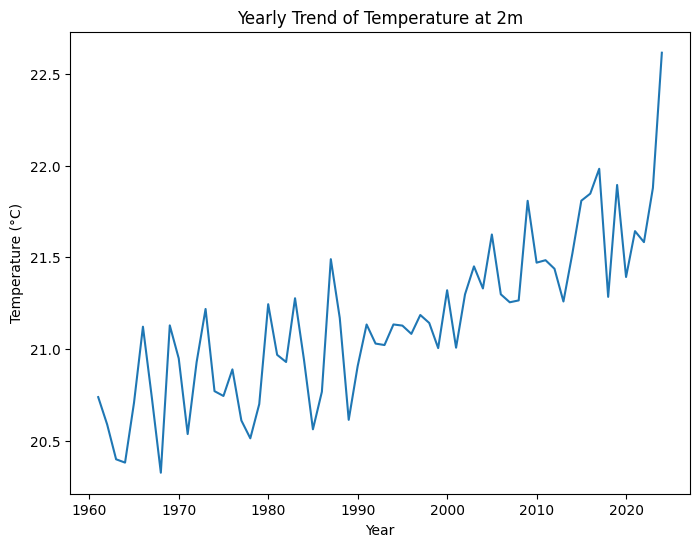

In [ ]:
# Time Series Plot for Temperature at 2m
plt.figure(figsize=(8, 6))
sns.lineplot(x='year', y='temperature_2m (°C)', data=data, ci=None)
plt.title('Yearly Trend of Temperature at 2m')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


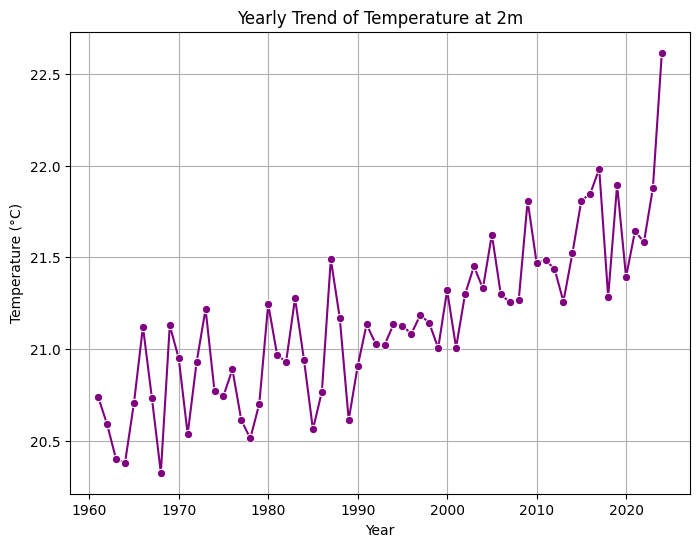

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Group by year and calculate the mean temperature for each year
yearly_temperature = data.groupby('year')['temperature_2m (°C)'].mean()

# Plot the yearly temperature trend
plt.figure(figsize=(8, 6))
sns.lineplot(x=yearly_temperature.index, y=yearly_temperature, marker='o', color='purple')
plt.title('Yearly Trend of Temperature at 2m')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.grid(True)
plt.show()

# Moving Average

A moving average helps to smooth out short-term fluctuations and reveal longer-term trends.

**Moving Average of Temperature**

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


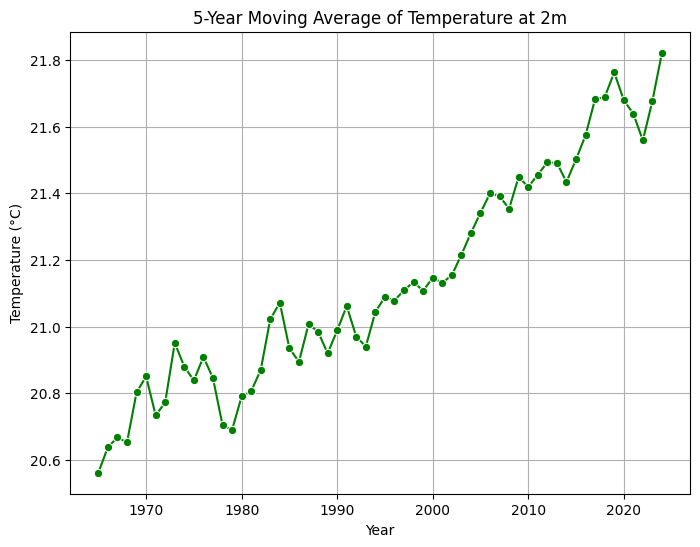

In [ ]:
# Calculate a 5-year moving average for temperature
yearly_temperature_ma = yearly_temperature.rolling(window=5).mean()

# Plot the moving average
plt.figure(figsize=(8, 6))
sns.lineplot(x=yearly_temperature_ma.index, y=yearly_temperature_ma, marker='o', color='green')
plt.title('5-Year Moving Average of Temperature at 2m')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.grid(True)
plt.show()

# Univariate Analysis
For continuous features:

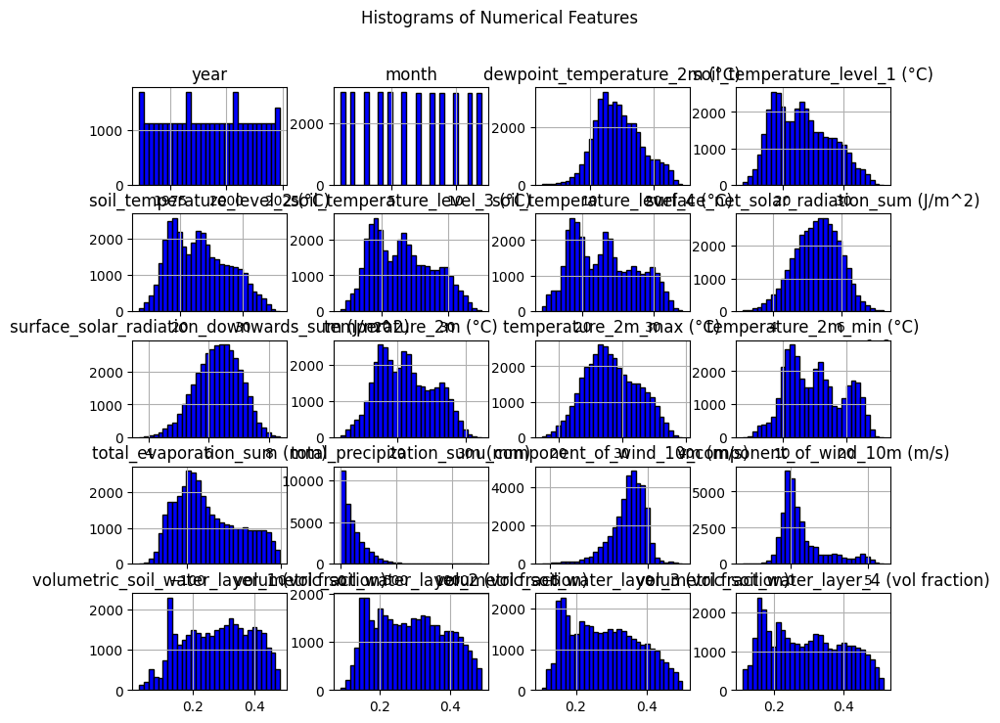

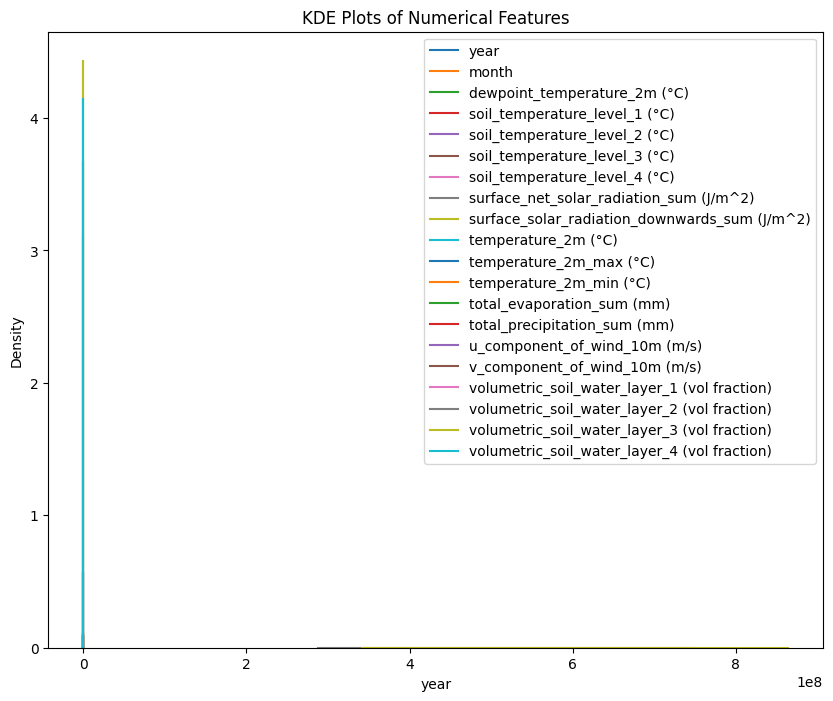

In [ ]:
# Histograms and KDE plots
data.hist(figsize=(10, 8), bins=30, color='blue', edgecolor='black')
plt.suptitle('Histograms of Numerical Features')
plt.show()

# KDE plots
plt.figure(figsize=(10, 8))
for column in data.select_dtypes(include=[float, int]).columns:
    sns.kdeplot(data[column], label=column)
plt.legend()
plt.title('KDE Plots of Numerical Features')
plt.show()

# For categorical features:

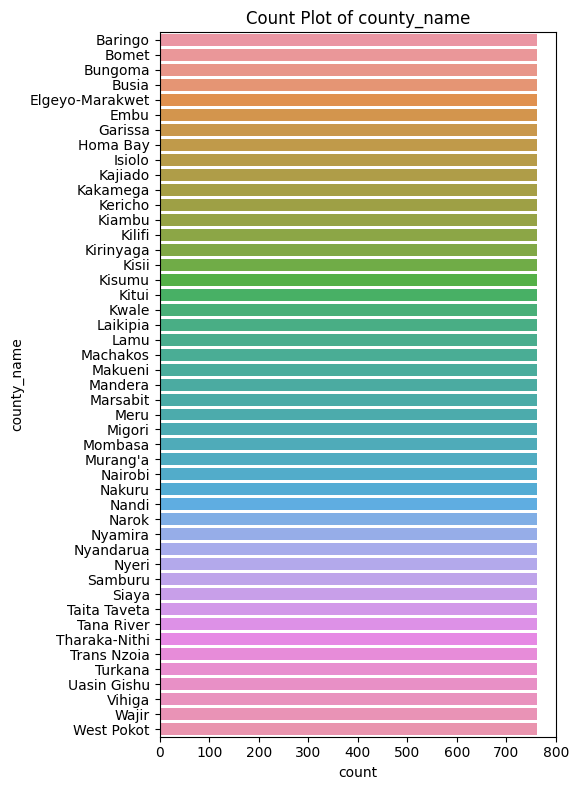

In [ ]:
# Count plots for categorical columns
categorical_cols = data.select_dtypes(include=[object]).columns
plt.figure(figsize=(10, 8))
for i, col in enumerate(categorical_cols, 1):
    plt.subplot(len(categorical_cols)//2 + 1, 2, i)
    sns.countplot(y=data[col], order=data[col].value_counts().index)
    plt.title(f'Count Plot of {col}')
plt.tight_layout()
plt.show()

# Bivariate Analysis

Understanding relationships between pairs of variables:

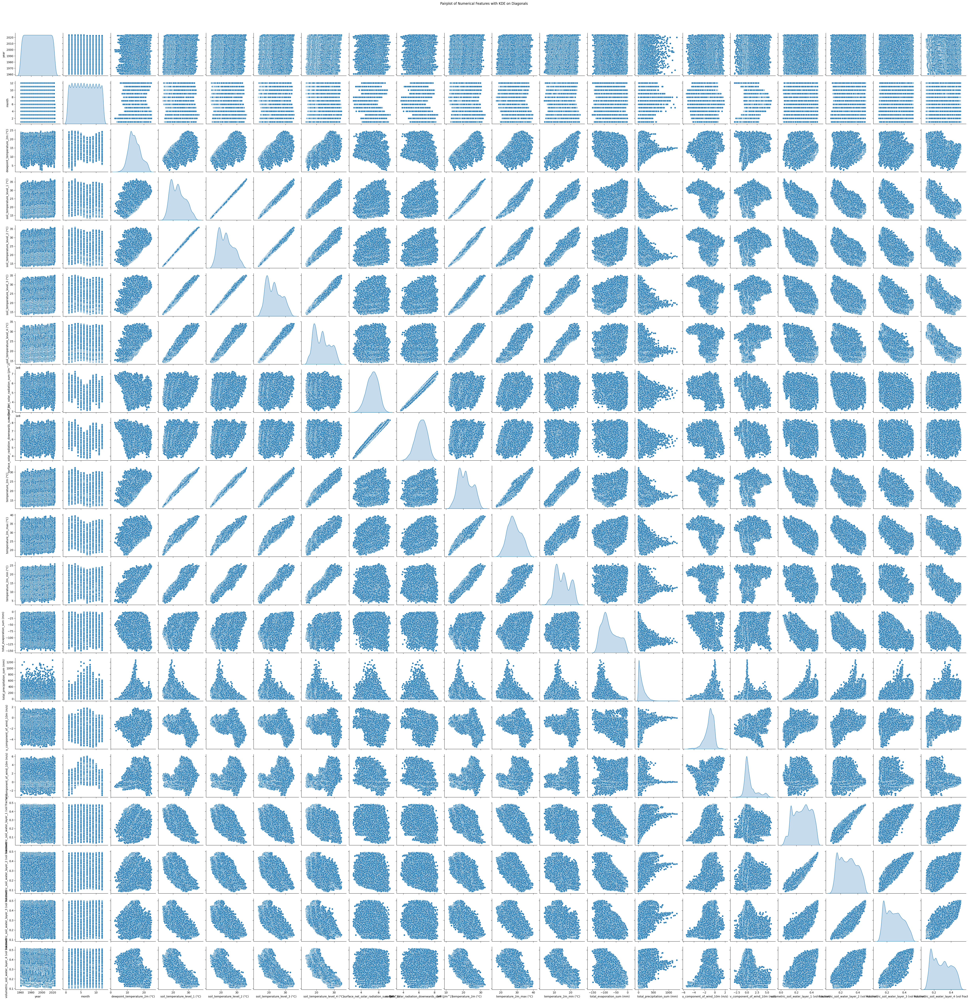

In [ ]:
sns.pairplot(data.select_dtypes(include=[float, int]), palette='Set1', diag_kind='kde')
plt.suptitle('Pairplot of Numerical Features with KDE on Diagonals', y=1.02)
plt.show()

# Correlation Analysis

In [ ]:
# Select only numeric columns
numeric_data = data.select_dtypes(include=[float, int])

# Calculate the correlation matrix
correlation_matrix = numeric_data.corr()

# Display the correlation matrix
print(correlation_matrix)

                                                   year     month  \
year                                           1.000000 -0.011851   
month                                         -0.011851  1.000000   
dewpoint_temperature_2m (°C)                   0.004763  0.023959   
soil_temperature_level_1 (°C)                  0.079675 -0.124496   
soil_temperature_level_2 (°C)                  0.080013 -0.118745   
soil_temperature_level_3 (°C)                  0.080559 -0.101146   
soil_temperature_level_4 (°C)                  0.080404 -0.060355   
surface_net_solar_radiation_sum (J/m^2)        0.033404 -0.217990   
surface_solar_radiation_downwards_sum (J/m^2)  0.034770 -0.228116   
temperature_2m (°C)                            0.085522 -0.121135   
temperature_2m_max (°C)                        0.100763 -0.181326   
temperature_2m_min (°C)                        0.061321 -0.048548   
total_evaporation_sum (mm)                     0.064198 -0.050466   
total_precipitation_sum (mm)      

# Heatmap

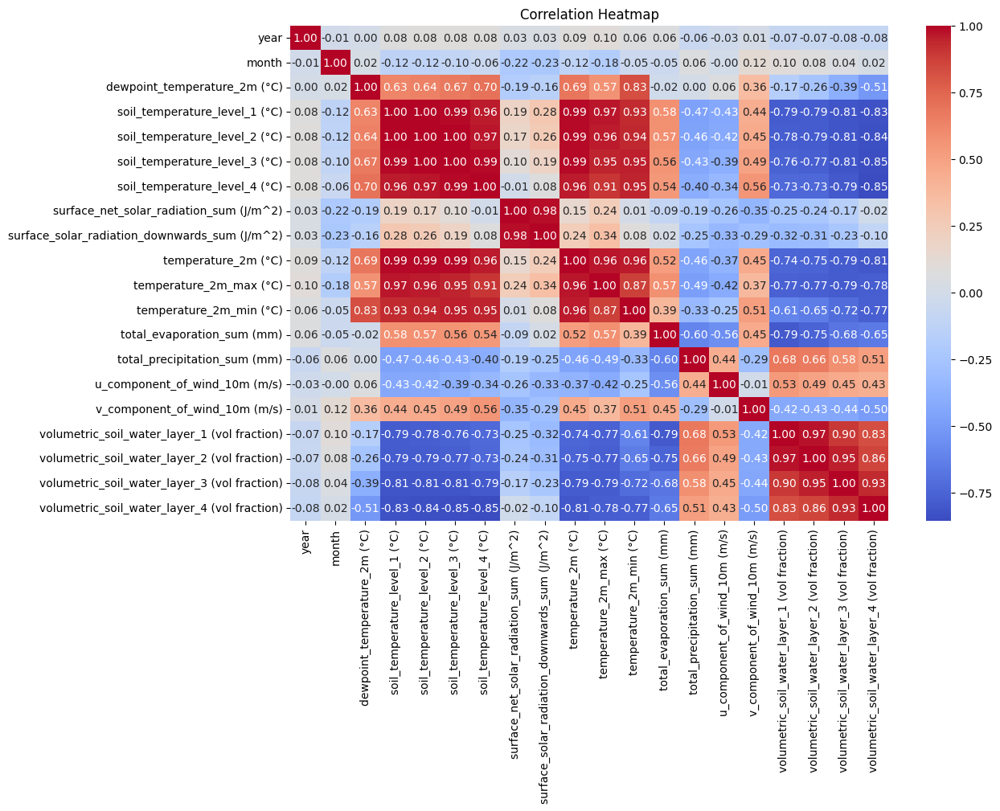

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title('Correlation Heatmap')
plt.show()

# Comparative Analysis:

Group by Analysis: Compare different subsets of the data (e.g., different decades, seasons)

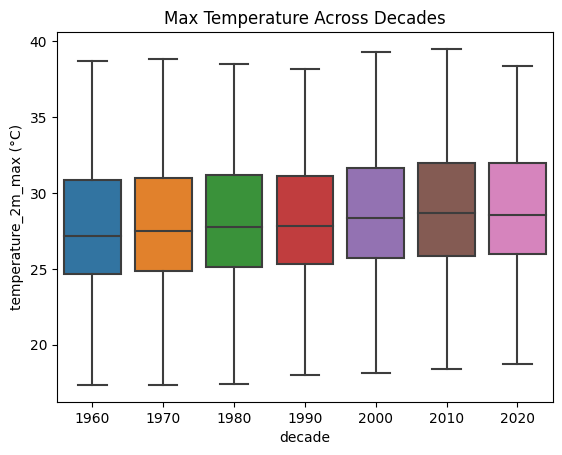

In [ ]:
data['decade'] = (data['year'] // 10) * 10
sns.boxplot(x='decade', y='temperature_2m_max (°C)', data=data)
plt.title('Max Temperature Across Decades')
plt.show()


# Hypothesis Testing:
T-tests and ANOVA: Perform statistical tests to compare means between groups.

In [ ]:
from scipy.stats import ttest_ind
ttest_result = ttest_ind(data['temperature_2m_max (°C)'], data['dewpoint_temperature_2m (°C)'])
print('T-test result:', ttest_result)

T-test result: TtestResult(statistic=481.57735489754134, pvalue=0.0, df=71626.0)


# Multivariate Analysis

# Cluster Analysis (e.g., K-Means Clustering):

To group similar observations into clusters based on multiple features.

For Example: Grouping years with similar weather patterns.

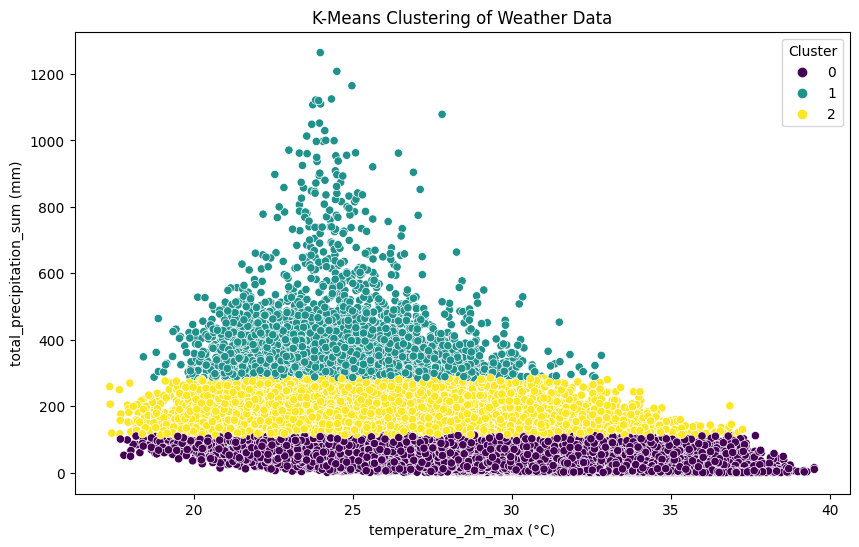

In [ ]:
from sklearn.cluster import KMeans

# Define the features for clustering
X = data[['temperature_2m_max (°C)', 'dewpoint_temperature_2m (°C)', 'total_precipitation_sum (mm)']]

# Apply K-Means clustering
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(X)

# Add the cluster labels to the dataset
data['Cluster'] = clusters

# Visualize the clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x='temperature_2m_max (°C)', y='total_precipitation_sum (mm)', hue='Cluster', data=data, palette='viridis')
plt.title('K-Means Clustering of Weather Data')
plt.show()


# Model Insights

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split

# Assume you have a binary target variable
# For example, create a binary target for demonstration (this should be your real classification target)
data['precipitation_binary'] = (data['total_precipitation_sum (mm)'] > data['total_precipitation_sum (mm)'].mean()).astype(int)

# Define the features and target variable
X = data[['temperature_2m_max (°C)', 'dewpoint_temperature_2m (°C)']]
y = data['precipitation_binary']  # Binary classification target

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train the Logistic Regression model
model = LogisticRegression()
model.fit(X_train, y_train)

# Predict the labels for the test set
y_pred = model.predict(X_test)

# Generate and print the classification report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.81      0.82      0.82      6678
           1       0.70      0.69      0.70      4067

    accuracy                           0.77     10745
   macro avg       0.76      0.76      0.76     10745
weighted avg       0.77      0.77      0.77     10745



# XGBoost

In [ ]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelEncoder

# Assuming 'data' is your DataFrame

# Create a binary target variable (replace this with your actual target variable)
# Example: Let's assume you want to classify based on whether total precipitation is above or below the mean.
data['precipitation_binary'] = (data['total_precipitation_sum (mm)'] > data['total_precipitation_sum (mm)'].mean()).astype(int)

# Define the features and the target
X = data[['temperature_2m_max (°C)', 'dewpoint_temperature_2m (°C)']]
y = data['precipitation_binary']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the XGBoost classifier
model = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss')

# Train the model
model.fit(X_train, y_train)

# Predict the labels for the test set
y_pred = model.predict(X_test)

# Generate and print the classification report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.83      0.84      0.84      6678
           1       0.74      0.72      0.73      4067

    accuracy                           0.80     10745
   macro avg       0.78      0.78      0.78     10745
weighted avg       0.80      0.80      0.80     10745



In [ ]:
!pip install statsmodels

# ARIMA Forecasting

              precision    recall  f1-score   support

           0       0.45      0.88      0.60        68
           1       0.60      0.14      0.23        85

    accuracy                           0.47       153
   macro avg       0.53      0.51      0.41       153
weighted avg       0.53      0.47      0.39       153

Mean Squared Error: 3.856651421174391


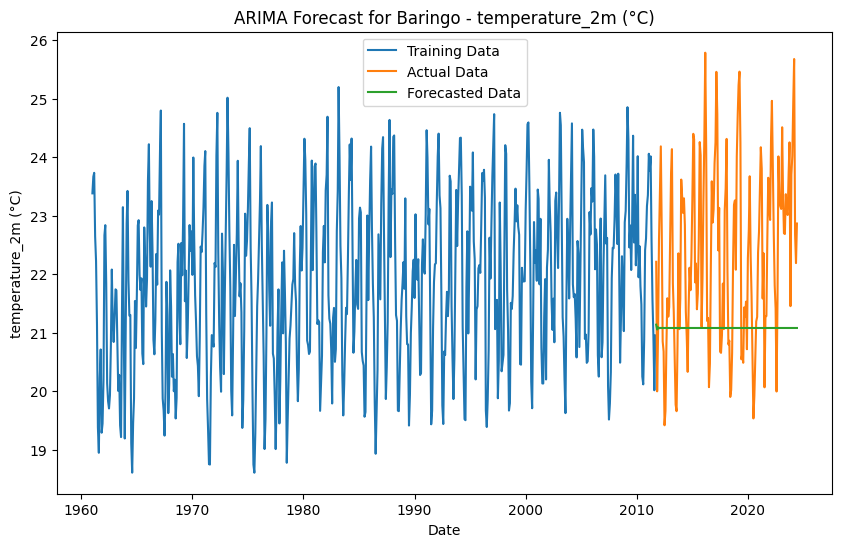

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import classification_report, mean_squared_error
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/kaggle/input/eraland5-county-1961-2024-csv/eraland5_county_1961_2024.csv'
data = pd.read_csv(file_path)

# Step 1: Filter data for a specific county and variable
county = 'Baringo'  # You can change this to any other county in the dataset
variable = 'temperature_2m (°C)'  # You can change this to any other variable in the dataset

filtered_data = data[data['county_name'] == county][['year', 'month', variable]]

# Step 2: Create a time series index
filtered_data['date'] = pd.to_datetime(filtered_data[['year', 'month']].assign(day=1))
filtered_data.set_index('date', inplace=True)
time_series = filtered_data[variable]

# Step 3: Split the data into training and test sets
train_size = int(len(time_series) * 0.8)
train, test = time_series[:train_size], time_series[train_size:]

# Step 4: Fit ARIMA model
arima_model = ARIMA(train, order=(1, 1, 1))
arima_result = arima_model.fit()

# Step 5: Forecast
forecast = arima_result.forecast(steps=len(test))

# Step 6: Convert continuous data to binary categories (1 for increase, 0 for decrease)
def to_direction(series):
    return np.where(series.diff().fillna(0) > 0, 1, 0)

test_direction = to_direction(test)
forecast_direction = to_direction(pd.Series(forecast, index=test.index))

# Step 7: Generate classification report
print(classification_report(test_direction, forecast_direction))

# Optional: Calculate and print Mean Squared Error
mse = mean_squared_error(test, forecast)
print(f'Mean Squared Error: {mse}')

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(train.index, train, label='Training Data')
plt.plot(test.index, test, label='Actual Data')
plt.plot(test.index, forecast, label='Forecasted Data')
plt.title(f'ARIMA Forecast for {county} - {variable}')
plt.xlabel('Date')
plt.ylabel(variable)
plt.legend()
plt.show()

# Auto ARIMA

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=inf, Time=2.42 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1890.030, Time=0.07 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1764.688, Time=0.28 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1815.833, Time=0.39 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1888.038, Time=0.07 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1886.444, Time=0.09 sec
 ARIMA(1,1,0)(2,0,0)[12] intercept   : AIC=1700.102, Time=0.68 sec
 ARIMA(1,1,0)(2,0,1)[12] intercept   : AIC=inf, Time=4.64 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=1.61 sec
 ARIMA(0,1,0)(2,0,0)[12] intercept   : AIC=1715.606, Time=0.54 sec
 ARIMA(2,1,0)(2,0,0)[12] intercept   : AIC=1679.540, Time=1.08 sec
 ARIMA(2,1,0)(1,0,0)[12] intercept   : AIC=1742.851, Time=0.36 sec
 ARIMA(2,1,0)(2,0,1)[12] intercept   : AIC=inf, Time=4.44 sec
 ARIMA(2,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=3.93 sec
 ARIMA(3,1,0)(2,0,0)[12] intercept   : AIC=1

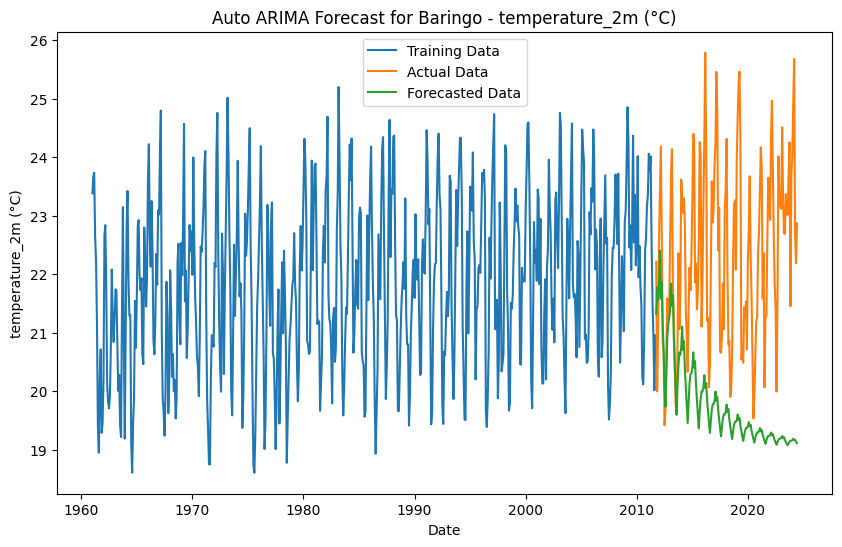

In [ ]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.metrics import classification_report, mean_squared_error
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/kaggle/input/eraland5-county-1961-2024-csv/eraland5_county_1961_2024.csv'
data = pd.read_csv(file_path)

# Step 1: Filter data for a specific county and variable
county = 'Baringo'  # You can change this to any other county in the dataset
variable = 'temperature_2m (°C)'  # You can change this to any other variable in the dataset

filtered_data = data[data['county_name'] == county][['year', 'month', variable]]

# Step 2: Create a time series index
filtered_data['date'] = pd.to_datetime(filtered_data[['year', 'month']].assign(day=1))
filtered_data.set_index('date', inplace=True)
time_series = filtered_data[variable]

# Step 3: Split the data into training and test sets
train_size = int(len(time_series) * 0.8)
train, test = time_series[:train_size], time_series[train_size:]

# Step 4: Apply Auto ARIMA
model = auto_arima(train, seasonal=True, m=12, trace=True, error_action='ignore', suppress_warnings=True)
model.fit(train)

# Step 5: Forecast
forecast = model.predict(n_periods=len(test))

# Step 6: Convert continuous data to binary categories (1 for increase, 0 for decrease)
def to_direction(series):
    return np.where(series.diff().fillna(0) > 0, 1, 0)

test_direction = to_direction(test)
forecast_direction = to_direction(pd.Series(forecast, index=test.index))

# Step 7: Generate classification report
print(classification_report(test_direction, forecast_direction))

# Optional: Calculate and print Mean Squared Error
mse = mean_squared_error(test, forecast)
print(f'Mean Squared Error: {mse}')

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(train.index, train, label='Training Data')
plt.plot(test.index, test, label='Actual Data')
plt.plot(test.index, forecast, label='Forecasted Data')
plt.title(f'Auto ARIMA Forecast for {county} - {variable}')
plt.xlabel('Date')
plt.ylabel(variable)
plt.legend()
plt.show()

              precision    recall  f1-score   support

           0       0.75      0.72      0.74        68
           1       0.78      0.81      0.80        85

    accuracy                           0.77       153
   macro avg       0.77      0.77      0.77       153
weighted avg       0.77      0.77      0.77       153

Mean Squared Error: 0.959375214447023


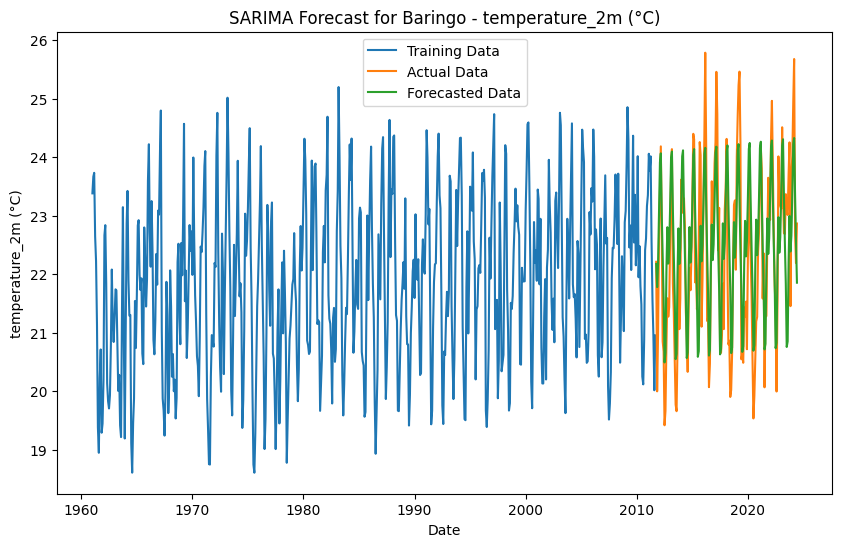

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import classification_report, mean_squared_error
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/kaggle/input/eraland5-county-1961-2024-csv/eraland5_county_1961_2024.csv'
data = pd.read_csv(file_path)

# Step 1: Filter data for a specific county and variable
county = 'Baringo'  # You can change this to any other county in the dataset
variable = 'temperature_2m (°C)'  # You can change this to any other variable in the dataset

filtered_data = data[data['county_name'] == county][['year', 'month', variable]]

# Step 2: Create a time series index
filtered_data['date'] = pd.to_datetime(filtered_data[['year', 'month']].assign(day=1))
filtered_data.set_index('date', inplace=True)
time_series = filtered_data[variable]

# Step 3: Split the data into training and test sets
train_size = int(len(time_series) * 0.8)
train, test = time_series[:train_size], time_series[train_size:]

# Step 4: Fit SARIMA model
sarima_model = SARIMAX(train, order=(1, 1, 1), seasonal_order=(1, 1, 1, 12), enforce_stationarity=False, enforce_invertibility=False)
sarima_result = sarima_model.fit(disp=False)

# Step 5: Forecast
forecast = sarima_result.get_forecast(steps=len(test))
forecast_mean = forecast.predicted_mean

# Step 6: Convert continuous data to binary categories (1 for increase, 0 for decrease)
def to_direction(series):
    return np.where(series.diff().fillna(0) > 0, 1, 0)

test_direction = to_direction(test)
forecast_direction = to_direction(forecast_mean)

# Step 7: Generate classification report
print(classification_report(test_direction, forecast_direction))

# Optional: Calculate and print Mean Squared Error
mse = mean_squared_error(test, forecast_mean)
print(f'Mean Squared Error: {mse}')

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(train.index, train, label='Training Data')
plt.plot(test.index, test, label='Actual Data')
plt.plot(test.index, forecast_mean, label='Forecasted Data')
plt.title(f'SARIMA Forecast for {county} - {variable}')
plt.xlabel('Date')
plt.ylabel(variable)
plt.legend()
plt.show()


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=inf, Time=2.09 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=1890.030, Time=0.07 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=1764.688, Time=0.25 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=1815.833, Time=0.35 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=1888.038, Time=0.07 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=1886.444, Time=0.09 sec
 ARIMA(1,1,0)(2,0,0)[12] intercept   : AIC=1700.102, Time=0.67 sec
 ARIMA(1,1,0)(2,0,1)[12] intercept   : AIC=inf, Time=4.19 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=1.40 sec
 ARIMA(0,1,0)(2,0,0)[12] intercept   : AIC=1715.606, Time=0.48 sec
 ARIMA(2,1,0)(2,0,0)[12] intercept   : AIC=1679.540, Time=0.86 sec
 ARIMA(2,1,0)(1,0,0)[12] intercept   : AIC=1742.851, Time=0.32 sec
 ARIMA(2,1,0)(2,0,1)[12] intercept   : AIC=inf, Time=3.92 sec
 ARIMA(2,1,0)(1,0,1)[12] intercept   : AIC=inf, Time=2.15 sec
 ARIMA(3,1,0)(2,0,0)[12] intercept   : AIC=1

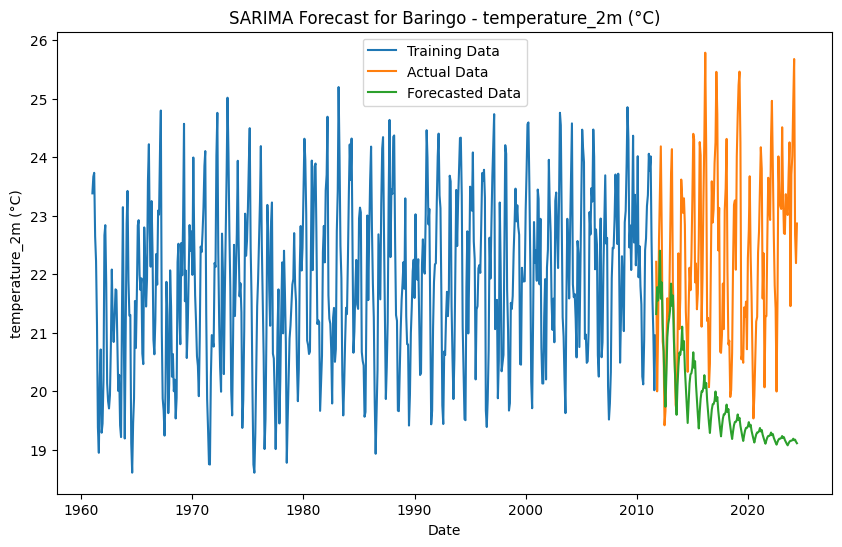

In [ ]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/kaggle/input/eraland5-county-1961-2024-csv/eraland5_county_1961_2024.csv'
data = pd.read_csv(file_path)

# Step 1: Filter data for a specific county and variable
county = 'Baringo'  # You can change this to any other county in the dataset
variable = 'temperature_2m (°C)'  # You can change this to any other variable in the dataset

filtered_data = data[data['county_name'] == county][['year', 'month', variable]]

# Step 2: Create a time series index
filtered_data['date'] = pd.to_datetime(filtered_data[['year', 'month']].assign(day=1))
filtered_data.set_index('date', inplace=True)
time_series = filtered_data[variable]

# Step 3: Split the data into training and test sets
train_size = int(len(time_series) * 0.8)
train, test = time_series[:train_size], time_series[train_size:]

# Step 4: Auto ARIMA for fine-tuning SARIMA parameters
model = auto_arima(train,
                   seasonal=True,
                   m=12,  # Season length, 12 for monthly data
                   trace=True,
                   error_action='ignore',
                   suppress_warnings=True,
                   stepwise=True)

# Print the selected model parameters
print(model.summary())

# Step 5: Forecast
forecast = model.predict(n_periods=len(test))

# Calculate and print Mean Squared Error
mse = mean_squared_error(test, forecast)
print(f'Mean Squared Error: {mse}')

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(train.index, train, label='Training Data')
plt.plot(test.index, test, label='Actual Data')
plt.plot(test.index, forecast, label='Forecasted Data')
plt.title(f'SARIMA Forecast for {county} - {variable}')
plt.xlabel('Date')
plt.ylabel(variable)
plt.legend()
plt.show()

# AutoML

In [ ]:
#import pandas as pd
#from sklearn.model_selection import train_test_split
#from sklearn.preprocessing import LabelEncoder
#from sklearn.metrics import classification_report
#from tpot import TPOTClassifier
#from sklearn.ensemble import RandomForestClassifier
#from sklearn.model_selection import GridSearchCV

# Load dataset
#file_path = '/kaggle/input/eraland5-county-1961-2024-csv/eraland5_county_1961_2024.csv'
#df = pd.read_csv(file_path)

# Preprocess the data
# Encode the target variable (county_name)
#label_encoder = LabelEncoder()
#df['county_name'] = label_encoder.fit_transform(df['county_name'])

# Features and target
#X = df.drop(columns=['county_name'])
#y = df['county_name']

# Split the data
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# AutoML with TPOT to find the best model pipeline
#tpot = TPOTClassifier(verbosity=2, generations=5, population_size=20, random_state=42)
#tpot.fit(X_train, y_train)

# Export the best pipeline found by TPOT
#tpot.export('tpot_best_pipeline.py')

# Evaluate the model on the test set
#y_pred = tpot.predict(X_test)
#print(classification_report(y_test, y_pred))

# Fine-tuning: If TPOT found a RandomForestClassifier, we can fine-tune it further
# Example: Let's say TPOT chose RandomForestClassifier, we now fine-tune it

#rf_model = RandomForestClassifier(random_state=42)
#param_grid = {
   # 'n_estimators': [100, 200, 300],
   # 'max_depth': [10, 20, 30],
    #'min_samples_split': [2, 5, 10],
#}

#grid_search = GridSearchCV(estimator=rf_model, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
#grid_search.fit(X_train, y_train)

# Best parameters and the best model
#print("Best parameters found: ", grid_search.best_params_)
#best_model = grid_search.best_estimator_
 #is outdated. Version 0.12.2 was released Friday February 23, 2024.
#Optimization Progress:   2%

# Final evaluation on the test set
#y_pred_fine_tuned = best_model.predict(X_test)
#print(classification_report(y_test, y_pred_fine_tuned))